In [1]:
using Arpack
using LinearAlgebra
using CairoMakie
using LaTeXStrings
using Revise
using Interpolations
using Roots
using ColorSchemes
using Colors
include("/Users/avadali/Desktop/Desktop - Avi's Mac/Summer2024/AHC_code/Spinors/rmg_K.jl")
include("/Users/avadali/Desktop/Desktop - Avi's Mac/Summer2024/AHC_code/Lattice_setup/lattice_BZ.jl")
include("/Users/avadali/Desktop/Desktop - Avi's Mac/Summer2024/AHC_code/3P_funcs/patch_methods.jl")
include("/Users/avadali/Desktop/Desktop - Avi's Mac/Summer2024/AHC_code/3P_funcs/rmg_3pV.jl")

rmg_inf_layer_alpha (generic function with 1 method)

In [137]:
function explicit_og_bc_vF(delta, alpha, index, vF)
    omega = exp(im * 2 * pi/ 3)
    k = index - 1
    v = vF
    
    nmz = 16 * real(omega^k * delta)^4 + 3 * abs(delta)^4 + 8 * real(delta^3) * real(omega^k * delta)
    
    return ((8 * sqrt(3) / nmz^2) * (8 * v * real(omega^k * delta)^3 - 12 * real(alpha * conj(delta)) * real(omega^k * delta)^2 + 
    3 * abs2(delta) * real(alpha * conj(delta)) + v * real(delta^3)) * (4 * real(omega^k * delta)^2 * imag(alpha * conj(delta)) + 
    4 * real(omega^k * delta) * imag(alpha * delta^2) - v * imag(delta^3) + abs2(delta) * imag(alpha * conj(delta))))
    
end

explicit_og_bc_vF (generic function with 1 method)

In [217]:
function approx_sign(x; tol=1e-15)
    if x > tol
        return 1
    elseif x < -tol
        return -1
    else
        return 0
    end
end

approx_sign (generic function with 1 method)

The idea of this notebook is that I would like to map out the "phase diagram" of the pure 3-patch Berry curvature. The only parameters that matter here for the sign are $\arg(\Delta), \arg(\alpha), \frac{v_F}{|\alpha|}$.

## Phase diagram of Berry curvature for individual bands

In [69]:
function phase_diagram_phi_theta(vF, k)
    n_pts = 10^2
    angles = range(-pi, pi, n_pts)
    grid = mesh_grid(angles, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_pts*n_pts
        phi = grid[j, 1]
        delta = exp(im * phi)
        theta = grid[j, 2]
        alpha = exp(im * theta)
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    fig = Figure(size=(2000, 1500), fontsize=50, fonts = (; regular = "italic", weird = "bold"))
    ax1 = Axis(fig[1, 1], title = L"\frac{1}{\pi}(\phi, \theta) \ \text{ vs } \ \text{sgn}(\tilde{\Omega}_k)", xlabel = L"\frac{\phi}{\pi}", 
    ylabel = L"\frac{\theta}{\pi}")
    scatter!(ax1, pos_points, marker = :hexagon, color=:red, markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=:blue, markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=:black, markersize=12, label = L"\tilde{\Omega}_k = 0")
    fig[1, 2] = Legend(fig, ax1, framevisible = true)
    
    fig
end

phase_diagram_phi_theta (generic function with 1 method)

In [71]:
approx_sign(explicit_og_bc_vF(1, 1/2, 0 + 1, 0.1/2))

0

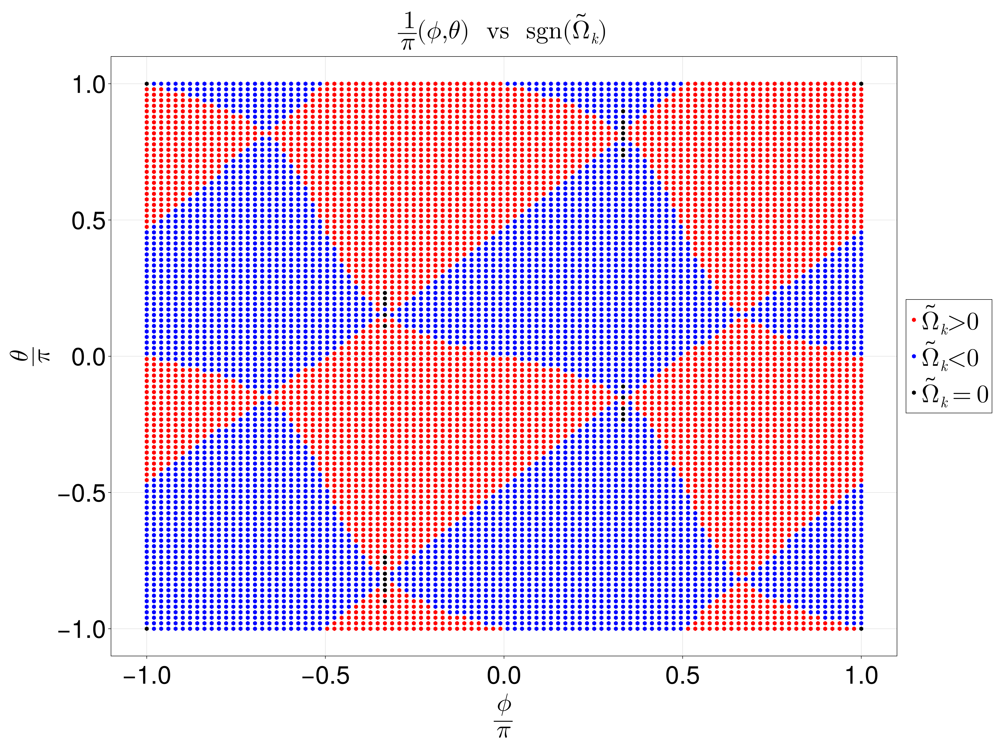

In [72]:
phase_diagram_phi_theta(0.1, 0)

In [74]:
function phase_diagram_phi_vF(theta, k)
    n_ang_pts = 10^2
    n_mag_pts = 10^2
    angles = range(-pi, pi, n_ang_pts)
    mags = range(0, 40, n_mag_pts)
    grid = mesh_grid(mags, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_ang_pts*n_mag_pts
        phi = grid[j, 2]
        delta = exp(im * phi)
        alpha = exp(im * theta)
        vF = grid[j, 1]
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    fig = Figure(size=(2000, 1500), fontsize=50, fonts = (; regular = "italic", weird = "bold"))
    ax1 = Axis(fig[1, 1], title = L"(v_F, \frac{\phi}{\pi}) \ \text{ vs } \ \text{sgn}(\tilde{\Omega}_k)", xlabel = L"v_F", 
    ylabel = L"\frac{\phi}{\pi}")
    scatter!(ax1, pos_points, marker = :hexagon, color=:red, markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=:blue, markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=:black, markersize=12, label = L"\tilde{\Omega}_k = 0")
    fig[1, 2] = Legend(fig, ax1, framevisible = true)
    
    fig
end

phase_diagram_phi_vF (generic function with 1 method)

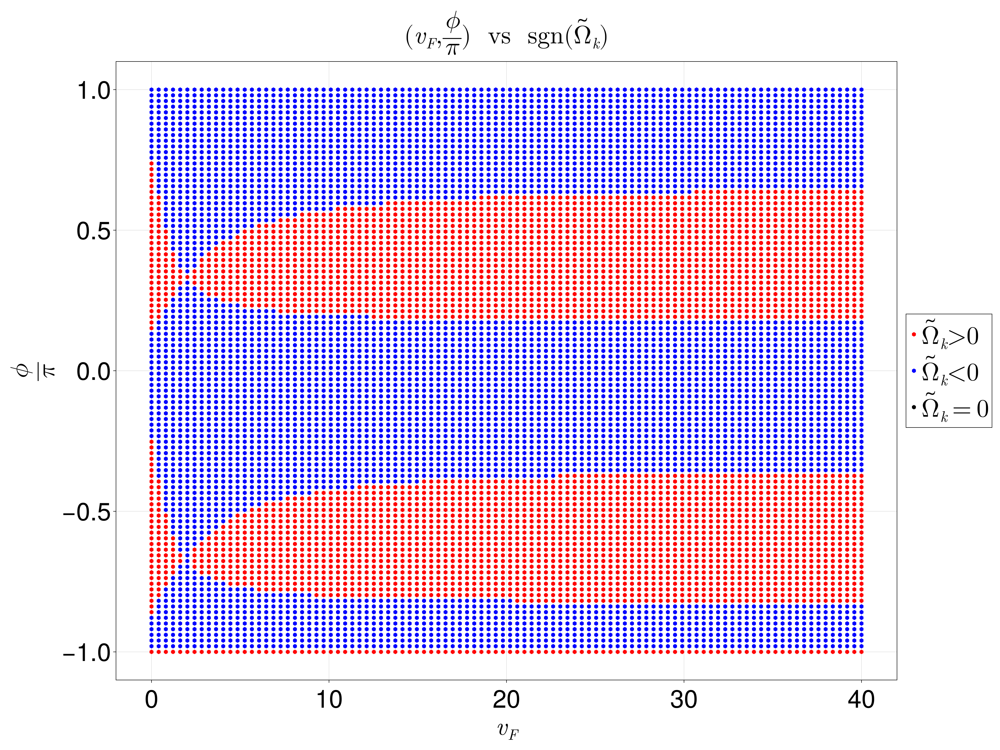

In [75]:
phase_diagram_phi_vF(pi/4, 2)

In [76]:
function phase_diagram_theta_vF(phi, k)
    n_ang_pts = 10^2
    n_mag_pts = 10^2
    angles = range(-pi, pi, n_ang_pts)
    mags = range(0, 40, n_mag_pts)
    grid = mesh_grid(mags, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_ang_pts*n_mag_pts
        theta = grid[j, 2]
        delta = exp(im * phi)
        alpha = exp(im * theta)
        vF = grid[j, 1]
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    fig = Figure(size=(2000, 1500), fontsize=50, fonts = (; regular = "italic", weird = "bold"))
    ax1 = Axis(fig[1, 1], title = L"(v_F, \frac{\theta}{\pi}) \ \text{ vs } \ \text{sgn}(\tilde{\Omega}_k)", xlabel = L"v_F", 
    ylabel = L"\frac{\theta}{\pi}")
    scatter!(ax1, pos_points, marker = :hexagon, color=:red, markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=:blue, markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=:black, markersize=12, label = L"\tilde{\Omega}_k = 0")
    fig[1, 2] = Legend(fig, ax1, framevisible = true)
    
    fig
end

phase_diagram_theta_vF (generic function with 1 method)

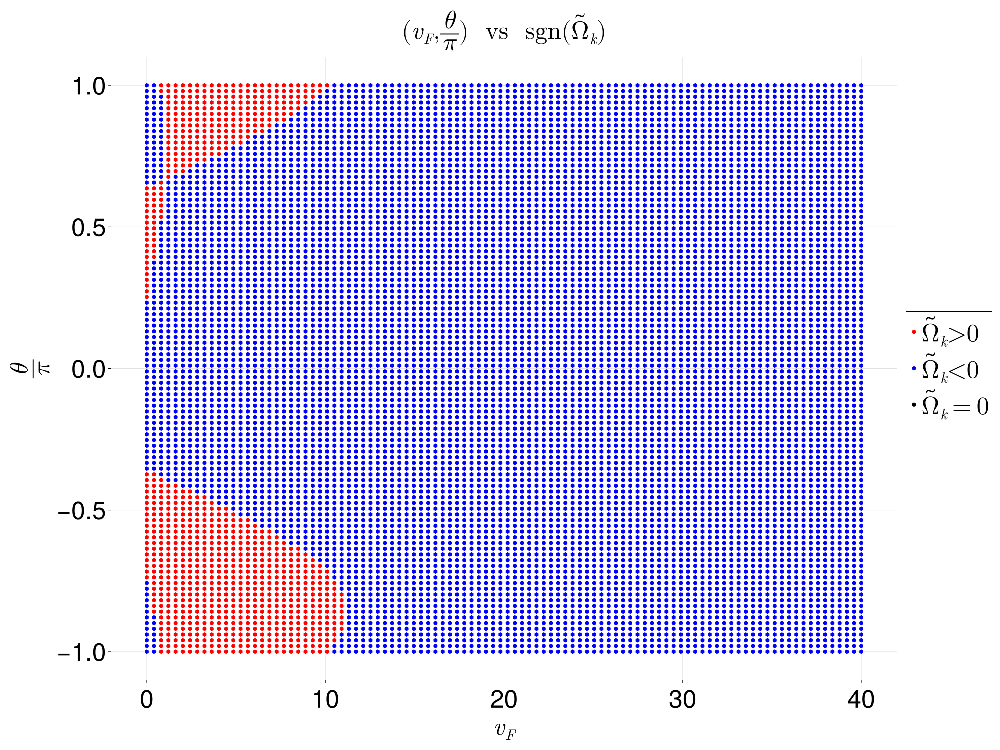

In [77]:
phase_diagram_theta_vF(7*pi/4, 2)

## Phase diagram of Berry curvature for lowest energy band

In [78]:
function phase_diagram_phi_theta_min(vF)
    n_pts = 10^2
    angles = range(-pi, pi, n_pts)
    grid = mesh_grid(angles, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_pts*n_pts
        phi = grid[j, 1]
        delta = exp(im * phi)
        theta = grid[j, 2]
        alpha = exp(im * theta)
        eigenvals = vF_analytic_eigenvalues(alpha/2, delta, 0, 0, vF/2)
        k = argmin(eigenvals)
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    fig = Figure(size=(2000, 1500), fontsize=50, fonts = (; regular = "italic", weird = "bold"))
    ax1 = Axis(fig[1, 1], title = L"\frac{1}{\pi}(\phi, \theta) \ \text{ vs } \ \text{sgn}(\tilde{\Omega})", xlabel = L"\frac{\phi}{\pi}", 
    ylabel = L"\frac{\theta}{\pi}")
    scatter!(ax1, pos_points, marker = :hexagon, color=:red, markersize=12, label = L"\tilde{\Omega} > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=:blue, markersize=12, label = L"\tilde{\Omega} < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=:black, markersize=12, label = L"\tilde{\Omega} = 0")
    fig[1, 2] = Legend(fig, ax1, framevisible = true)
    
    fig
end

phase_diagram_phi_theta_min (generic function with 1 method)

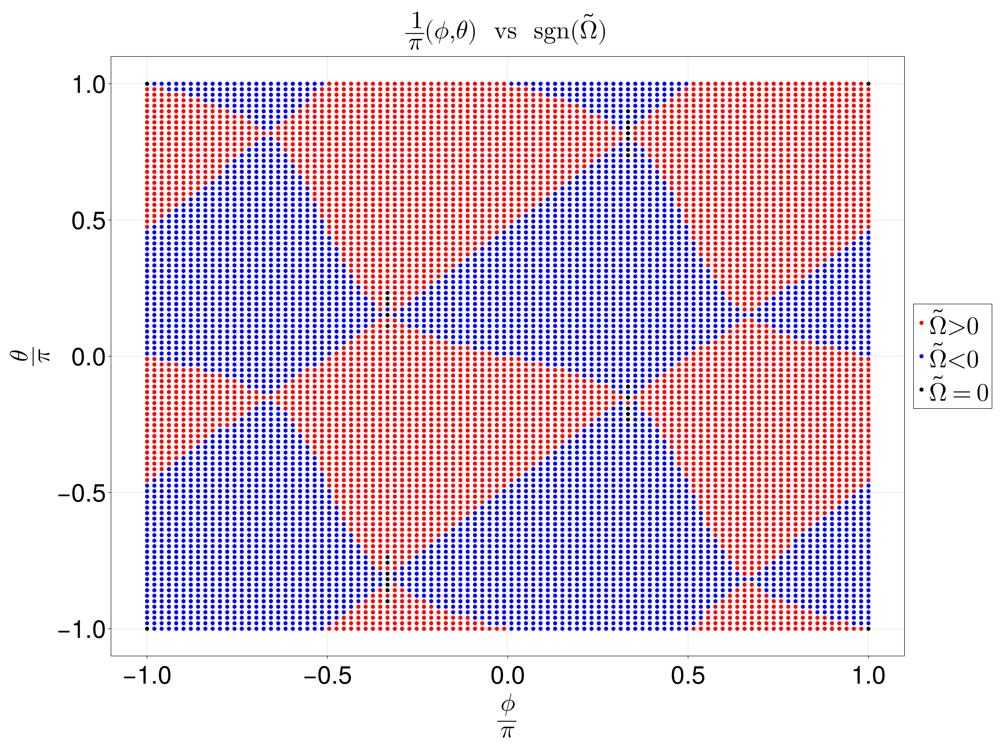

In [79]:
phase_diagram_phi_theta_min(0.1)

In [80]:
function phase_diagram_phi_vF_min(theta)
    n_ang_pts = 10^2
    n_mag_pts = 10^2
    angles = range(-pi, pi, n_ang_pts)
    mags = range(0, 40, n_mag_pts)
    grid = mesh_grid(mags, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_ang_pts*n_mag_pts
        phi = grid[j, 2]
        delta = exp(im * phi)
        alpha = exp(im * theta)
        vF = grid[j, 1]
        eigenvals = vF_analytic_eigenvalues(alpha/2, delta, 0, 0, vF/2)
        k = argmin(eigenvals)
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    fig = Figure(size=(2000, 1500), fontsize=50, fonts = (; regular = "italic", weird = "bold"))
    ax1 = Axis(fig[1, 1], title = L"(v_F, \frac{\phi}{\pi}) \ \text{ vs } \ \text{sgn}(\tilde{\Omega}_k)", xlabel = L"v_F", 
    ylabel = L"\frac{\phi}{\pi}")
    scatter!(ax1, pos_points, marker = :hexagon, color=:red, markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=:blue, markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=:black, markersize=12, label = L"\tilde{\Omega}_k = 0")
    fig[1, 2] = Legend(fig, ax1, framevisible = true)
    
    fig
end

phase_diagram_phi_vF_min (generic function with 1 method)

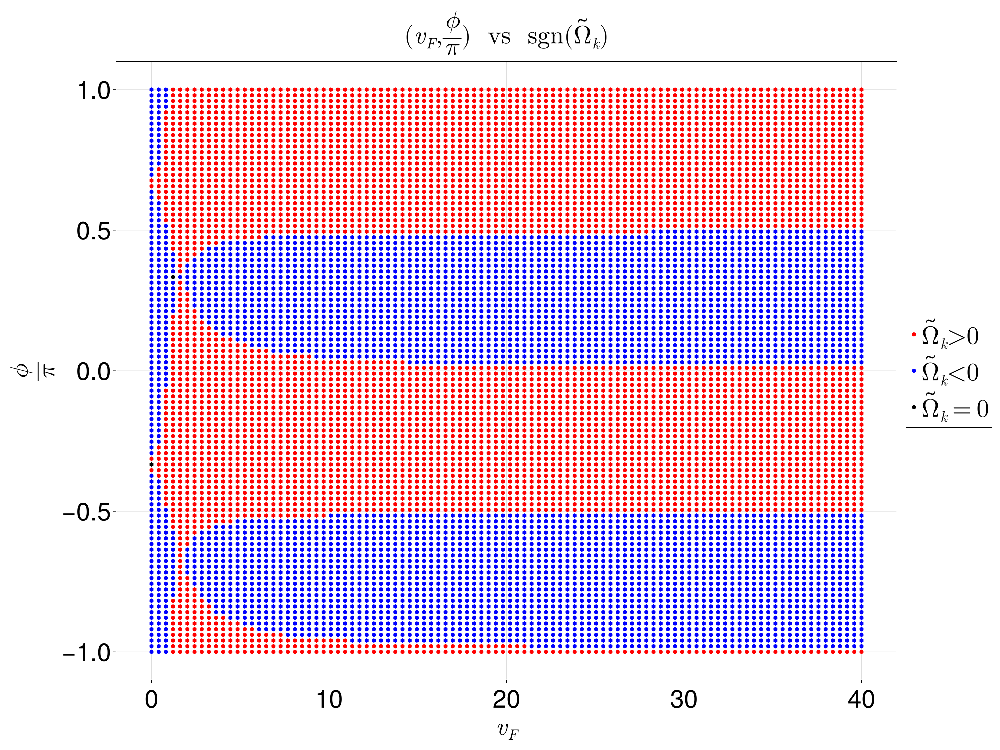

In [81]:
phase_diagram_phi_vF_min(pi/7)

In [82]:
function phase_diagram_theta_vF_min(phi)
    n_ang_pts = 10^2
    n_mag_pts = 10^2
    angles = range(-pi, pi, n_ang_pts)
    mags = range(0, 40, n_mag_pts)
    grid = mesh_grid(mags, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_ang_pts*n_mag_pts
        theta = grid[j, 2]
        delta = exp(im * phi)
        alpha = exp(im * theta)
        vF = grid[j, 1]
        eigenvals = vF_analytic_eigenvalues(alpha/2, delta, 0, 0, vF/2)
        k = argmin(eigenvals)
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    fig = Figure(size=(2000, 1500), fontsize=50, fonts = (; regular = "italic", weird = "bold"))
    ax1 = Axis(fig[1, 1], title = L"(v_F, \frac{\theta}{\pi}) \ \text{ vs } \ \text{sgn}(\tilde{\Omega}_k)", xlabel = L"v_F", 
    ylabel = L"\frac{\theta}{\pi}")
    scatter!(ax1, pos_points, marker = :hexagon, color=:red, markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=:blue, markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=:black, markersize=12, label = L"\tilde{\Omega}_k = 0")
    fig[1, 2] = Legend(fig, ax1, framevisible = true)
    
    fig
end

phase_diagram_theta_vF_min (generic function with 1 method)

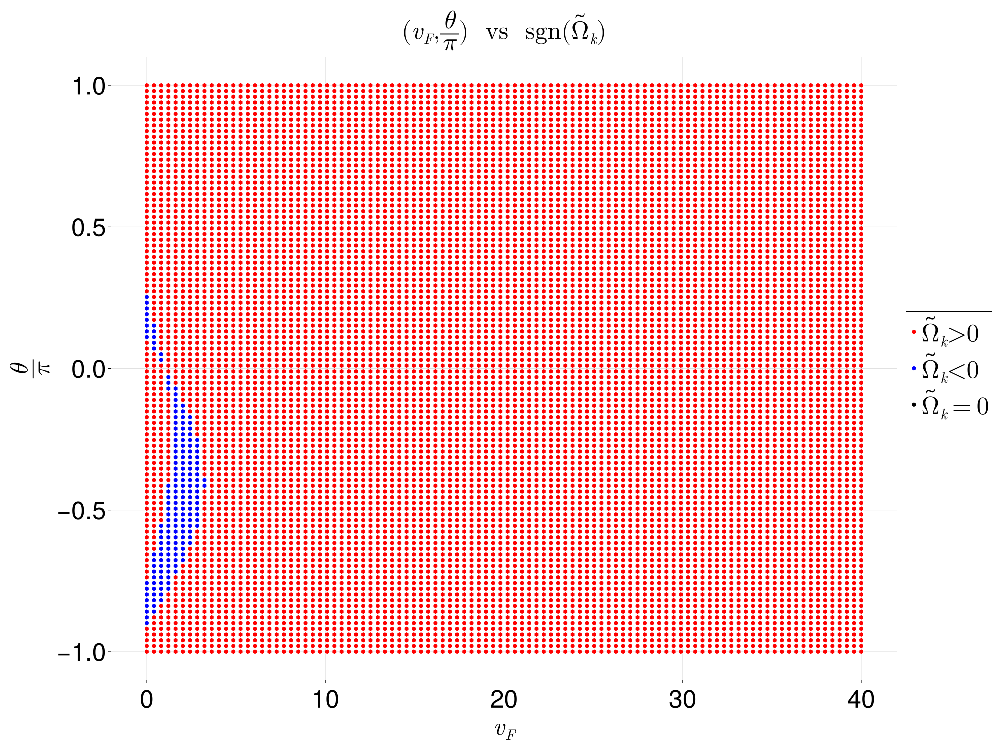

In [83]:
phase_diagram_theta_vF_min(3*pi/5)

## Analytic phase boundary plots

In [199]:
function wrap_angle(ang)
    return mod(ang + pi, 2pi) - pi
end

wrap_angle (generic function with 1 method)

In [200]:
function branch1_theta(vF, a, phi, k)
    return wrap_angle((phi + acos(vF/a * (cos(3*phi) + 2 * cos(phi + 2*pi*k/3)) / (1 + 2 * cos(2*phi + 4 * pi * k / 3)))))
end

branch1_theta (generic function with 1 method)

In [201]:
function branch2_roots(vF, a, varphi, k, n)
    theta = wrap_angle(varphi - 2*pi/3 * k)
    phi = wrap_angle(n*pi + atan(3 * sin(varphi) / (vF/a - cos(varphi))) + pi/3 * k)
    return [phi, theta]
end

branch2_roots (generic function with 1 method)

In [230]:
function phase_boundary_vF(vF, a, k)
    # plot the analytic phase boundaries
    n_pts = 10^4
    varphi_list = range(-pi, pi, n_pts)
    
    # root_sets = Array{Float64}(undef, 6, 2, n_pts)
    branch_2_roots = Array{Float64}(undef, 3, 2, n_pts)
    branch_1_roots = Array{Float64}(undef, 3, 2, n_pts)
    for j in 1:n_pts
        varphi = varphi_list[j]

        branch_2_roots[1, :, j] = branch2_roots(vF, a, varphi, k, -1)

        branch_2_roots[2, :, j] = branch2_roots(vF, a, varphi, k, 0)

        branch_2_roots[3, :, j] = branch2_roots(vF, a, varphi, k, 1)

        branch_1_roots[1, 1, j] = wrap_angle(varphi - pi)
        branch_1_roots[1, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[2, 1, j] = wrap_angle(varphi)
        branch_1_roots[2, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[3, 1, j] = wrap_angle(varphi + pi)
        branch_1_roots[3, 2, j] = branch1_theta(vF, a, varphi_list[j], k)
    end
    fig = Figure(size=(2000, 1500), fontsize=50, fonts = (; regular = "italic", weird = "bold"))
    ax1 = Axis(fig[1, 1], title = L"\frac{1}{\pi}(\phi, \theta) \ \text{ Phase Boundaries }", xlabel = L"\frac{\phi}{\pi}", 
    ylabel = L"\frac{\theta}{\pi}")

    for j in 1:size(branch_1_roots, 1)
        scatter!(ax1, 1/pi * branch_1_roots[j, 1, :], 1/pi * branch_1_roots[j, 2, :], color = :black)
    end
    for j in 1:size(branch_2_roots, 1)
        scatter!(ax1, 1/pi * branch_2_roots[j, 1, :], 1/pi * branch_2_roots[j, 2, :], color = :black)
    end

    # Plot the numeric phase diagram
    n_pts = 10^2
    angles = 0.99 * range(-pi, pi, n_pts)
    grid = mesh_grid(angles, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_pts*n_pts
        phi = grid[j, 1]
        delta = exp(im * phi)
        theta = grid[j, 2]
        alpha = a * exp(im * theta)
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    scatter!(ax1, pos_points, marker = :hexagon, color=(:red, 0.5), markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=(:blue, 0.5), markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=(:black, 0.5), markersize=12, label = L"\tilde{\Omega}_k = 0")
    fig[1, 2] = Legend(fig, ax1, framevisible = true)
    
    fig
end

phase_boundary_vF (generic function with 1 method)

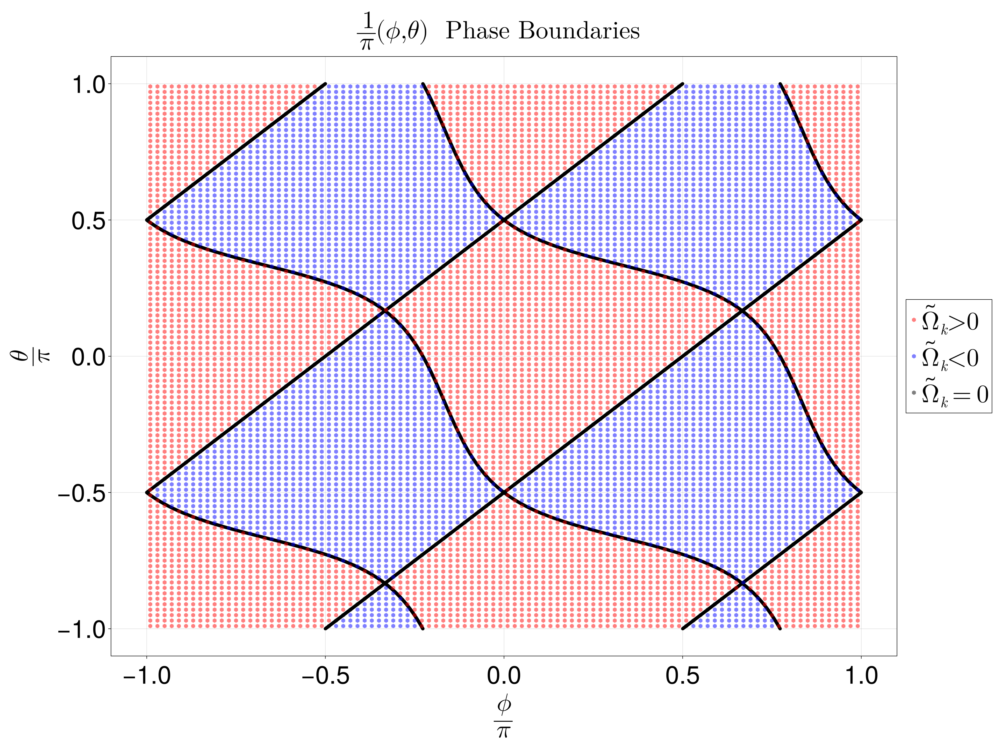

In [228]:
phase_boundary_vF(0, 1, 1)

## Now we can make a nice set of 4 phase diagrams for Tomo (proof of concept)

In [270]:
function phase_boundary_vF_grid_plot(vF_list, a, k)
    fig = Figure(size=(8000, 6000), fontsize=50, fonts = (; regular = "italic", weird = "bold"), figure_padding = 0)

    # (1, 1)
    vF = vF_list[1]
    # plot the analytic phase boundaries
    n_pts = 10^4
    varphi_list = range(-pi, pi, n_pts)
    
    # root_sets = Array{Float64}(undef, 6, 2, n_pts)
    branch_2_roots = Array{Float64}(undef, 3, 2, n_pts)
    branch_1_roots = Array{Float64}(undef, 3, 2, n_pts)
    for j in 1:n_pts
        varphi = varphi_list[j]

        branch_2_roots[1, :, j] = branch2_roots(vF, a, varphi, k, -1)

        branch_2_roots[2, :, j] = branch2_roots(vF, a, varphi, k, 0)

        branch_2_roots[3, :, j] = branch2_roots(vF, a, varphi, k, 1)

        branch_1_roots[1, 1, j] = wrap_angle(varphi - pi)
        branch_1_roots[1, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[2, 1, j] = wrap_angle(varphi)
        branch_1_roots[2, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[3, 1, j] = wrap_angle(varphi + pi)
        branch_1_roots[3, 2, j] = branch1_theta(vF, a, varphi_list[j], k)
    end
    ax1 = Axis(fig[1, 1], title = L"\ v_F = 0", xlabel = L"\frac{\phi}{\pi}", 
    ylabel = L"\frac{\theta}{\pi}", titlesize = 100, xlabelsize = 70, ylabelsize = 70)

    for j in 1:size(branch_1_roots, 1)
        scatter!(ax1, 1/pi * branch_1_roots[j, 1, :], 1/pi * branch_1_roots[j, 2, :], color = :black)
    end
    for j in 1:size(branch_2_roots, 1)
        scatter!(ax1, 1/pi * branch_2_roots[j, 1, :], 1/pi * branch_2_roots[j, 2, :], color = :black)
    end

    # Plot the numeric phase diagram
    n_pts = 10^2
    angles = 0.99 * range(-pi, pi, n_pts)
    grid = mesh_grid(angles, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_pts*n_pts
        phi = grid[j, 1]
        delta = exp(im * phi)
        theta = grid[j, 2]
        alpha = a * exp(im * theta)
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    scatter!(ax1, pos_points, marker = :hexagon, color=(:red, 0.5), markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax1, neg_points, marker = :hexagon, color=(:blue, 0.5), markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax1, zero_points, marker = :hexagon, color=(:black, 0.5), markersize=12, label = L"\tilde{\Omega}_k = 0")
    # fig[1, 2] = Legend(fig, ax1, framevisible = true)

    



    # (1, 2)
    vF = vF_list[2]
    # plot the analytic phase boundaries
    n_pts = 10^4
    varphi_list = range(-pi, pi, n_pts)
    
    # root_sets = Array{Float64}(undef, 6, 2, n_pts)
    branch_2_roots = Array{Float64}(undef, 3, 2, n_pts)
    branch_1_roots = Array{Float64}(undef, 3, 2, n_pts)
    for j in 1:n_pts
        varphi = varphi_list[j]

        branch_2_roots[1, :, j] = branch2_roots(vF, a, varphi, k, -1)

        branch_2_roots[2, :, j] = branch2_roots(vF, a, varphi, k, 0)

        branch_2_roots[3, :, j] = branch2_roots(vF, a, varphi, k, 1)

        branch_1_roots[1, 1, j] = wrap_angle(varphi - pi)
        branch_1_roots[1, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[2, 1, j] = wrap_angle(varphi)
        branch_1_roots[2, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[3, 1, j] = wrap_angle(varphi + pi)
        branch_1_roots[3, 2, j] = branch1_theta(vF, a, varphi_list[j], k)
    end
    ax2 = Axis(fig[1, 2], title = L" v_F = 0.25", xlabel = L"\frac{\phi}{\pi}", 
    ylabel = L"\frac{\theta}{\pi}", titlesize = 100, xlabelsize = 70, ylabelsize = 70)

    for j in 1:size(branch_1_roots, 1)
        scatter!(ax2, 1/pi * branch_1_roots[j, 1, :], 1/pi * branch_1_roots[j, 2, :], color = :black)
    end
    for j in 1:size(branch_2_roots, 1)
        scatter!(ax2, 1/pi * branch_2_roots[j, 1, :], 1/pi * branch_2_roots[j, 2, :], color = :black)
    end

    # Plot the numeric phase diagram
    n_pts = 10^2
    angles = 0.99 * range(-pi, pi, n_pts)
    grid = mesh_grid(angles, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_pts*n_pts
        phi = grid[j, 1]
        delta = exp(im * phi)
        theta = grid[j, 2]
        alpha = a * exp(im * theta)
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    scatter!(ax2, pos_points, marker = :hexagon, color=(:red, 0.5), markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax2, neg_points, marker = :hexagon, color=(:blue, 0.5), markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax2, zero_points, marker = :hexagon, color=(:black, 0.5), markersize=12, label = L"\tilde{\Omega}_k = 0")
    # fig[1, 2] = Legend(fig, ax1, framevisible = true)


    # (2, 1)
    vF = vF_list[3]
    # plot the analytic phase boundaries
    n_pts = 10^4
    varphi_list = range(-pi, pi, n_pts)
    
    # root_sets = Array{Float64}(undef, 6, 2, n_pts)
    branch_2_roots = Array{Float64}(undef, 3, 2, n_pts)
    branch_1_roots = Array{Float64}(undef, 3, 2, n_pts)
    for j in 1:n_pts
        varphi = varphi_list[j]

        branch_2_roots[1, :, j] = branch2_roots(vF, a, varphi, k, -1)

        branch_2_roots[2, :, j] = branch2_roots(vF, a, varphi, k, 0)

        branch_2_roots[3, :, j] = branch2_roots(vF, a, varphi, k, 1)

        branch_1_roots[1, 1, j] = wrap_angle(varphi - pi)
        branch_1_roots[1, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[2, 1, j] = wrap_angle(varphi)
        branch_1_roots[2, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[3, 1, j] = wrap_angle(varphi + pi)
        branch_1_roots[3, 2, j] = branch1_theta(vF, a, varphi_list[j], k)
    end
    ax3 = Axis(fig[2, 1], title = L"v_F = 0.5", xlabel = L"\frac{\phi}{\pi}", 
    ylabel = L"\frac{\theta}{\pi}", titlesize = 100, xlabelsize = 70, ylabelsize = 70)

    for j in 1:size(branch_1_roots, 1)
        scatter!(ax3, 1/pi * branch_1_roots[j, 1, :], 1/pi * branch_1_roots[j, 2, :], color = :black)
    end
    for j in 1:size(branch_2_roots, 1)
        scatter!(ax3, 1/pi * branch_2_roots[j, 1, :], 1/pi * branch_2_roots[j, 2, :], color = :black)
    end

    # Plot the numeric phase diagram
    n_pts = 10^2
    angles = 0.99 * range(-pi, pi, n_pts)
    grid = mesh_grid(angles, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_pts*n_pts
        phi = grid[j, 1]
        delta = exp(im * phi)
        theta = grid[j, 2]
        alpha = a * exp(im * theta)
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    scatter!(ax3, pos_points, marker = :hexagon, color=(:red, 0.5), markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax3, neg_points, marker = :hexagon, color=(:blue, 0.5), markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax3, zero_points, marker = :hexagon, color=(:black, 0.5), markersize=12, label = L"\tilde{\Omega}_k = 0")
    # fig[1, 2] = Legend(fig, ax1, framevisible = true)





    # (2, 2)
    vF = vF_list[4]
    # plot the analytic phase boundaries
    n_pts = 10^4
    varphi_list = range(-pi, pi, n_pts)
    
    # root_sets = Array{Float64}(undef, 6, 2, n_pts)
    branch_2_roots = Array{Float64}(undef, 3, 2, n_pts)
    branch_1_roots = Array{Float64}(undef, 3, 2, n_pts)
    for j in 1:n_pts
        varphi = varphi_list[j]

        branch_2_roots[1, :, j] = branch2_roots(vF, a, varphi, k, -1)

        branch_2_roots[2, :, j] = branch2_roots(vF, a, varphi, k, 0)

        branch_2_roots[3, :, j] = branch2_roots(vF, a, varphi, k, 1)

        branch_1_roots[1, 1, j] = wrap_angle(varphi - pi)
        branch_1_roots[1, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[2, 1, j] = wrap_angle(varphi)
        branch_1_roots[2, 2, j] = branch1_theta(vF, a, varphi_list[j], k)

        branch_1_roots[3, 1, j] = wrap_angle(varphi + pi)
        branch_1_roots[3, 2, j] = branch1_theta(vF, a, varphi_list[j], k)
    end
    ax4 = Axis(fig[2, 2], title = L"v_F = 0.75", xlabel = L"\frac{\phi}{\pi}", 
    ylabel = L"\frac{\theta}{\pi}", titlesize = 100, xlabelsize = 70, ylabelsize = 70)

    for j in 1:size(branch_1_roots, 1)
        scatter!(ax4, 1/pi * branch_1_roots[j, 1, :], 1/pi * branch_1_roots[j, 2, :], color = :black)
    end
    for j in 1:size(branch_2_roots, 1)
        scatter!(ax4, 1/pi * branch_2_roots[j, 1, :], 1/pi * branch_2_roots[j, 2, :], color = :black)
    end

    # Plot the numeric phase diagram
    n_pts = 10^2
    angles = 0.99 * range(-pi, pi, n_pts)
    grid = mesh_grid(angles, angles, Float64)
    pos_points = Point2f[]
    neg_points = Point2f[]
    zero_points = Point2f[]
    for j in 1:n_pts*n_pts
        phi = grid[j, 1]
        delta = exp(im * phi)
        theta = grid[j, 2]
        alpha = a * exp(im * theta)
        # properly enforce
        bc = explicit_og_bc_vF(delta, alpha/2, k + 1, vF/2)
        bc_sgn = approx_sign(bc)
        if bc_sgn < 0
            push!(neg_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        elseif bc_sgn > 0
            push!(pos_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        else
            push!(zero_points, Point2f(1/pi * grid[j, 1], 1/pi * grid[j, 2]))
        end
    end

    scatter!(ax4, pos_points, marker = :hexagon, color=(:red, 0.5), markersize=12, label = L"\tilde{\Omega}_k > 0")
    scatter!(ax4, neg_points, marker = :hexagon, color=(:blue, 0.5), markersize=12, label = L"\tilde{\Omega}_k < 0")
    scatter!(ax4, zero_points, marker = :hexagon, color=(:black, 0.5), markersize=12, label = L"\tilde{\Omega}_k = 0")
    
    axs = Axis(fig[:, :], 
    title = L"\text{Phase diagram in } \frac{1}{\pi}(\phi, \theta) \ \text{plane for } k = 2", titlegap = 150, titlesize = 120)
    hidedecorations!(axs, label = false)
    hidespines!(axs)


    legend =  Legend(fig[:, 3], ax1, framevisible = true, fontsize = 100)

    fig
end

phase_boundary_vF_grid_plot (generic function with 1 method)

In [271]:
vF_list = [0, 0.25, 0.5, 0.75]
phase_boundary_vF_grid_plot(vF_list, 1, 2)